# Домашнее задание к семинару №4

## Задача 1 

#### Постройте график. Назовите график. Делайте именование оси x и оси y. Делайте выводы

### 1.1 Скачать данные

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv('kc_house_data.csv',header = 0)
df.head()


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


### 1.2 Изучите стоимости недвижимости

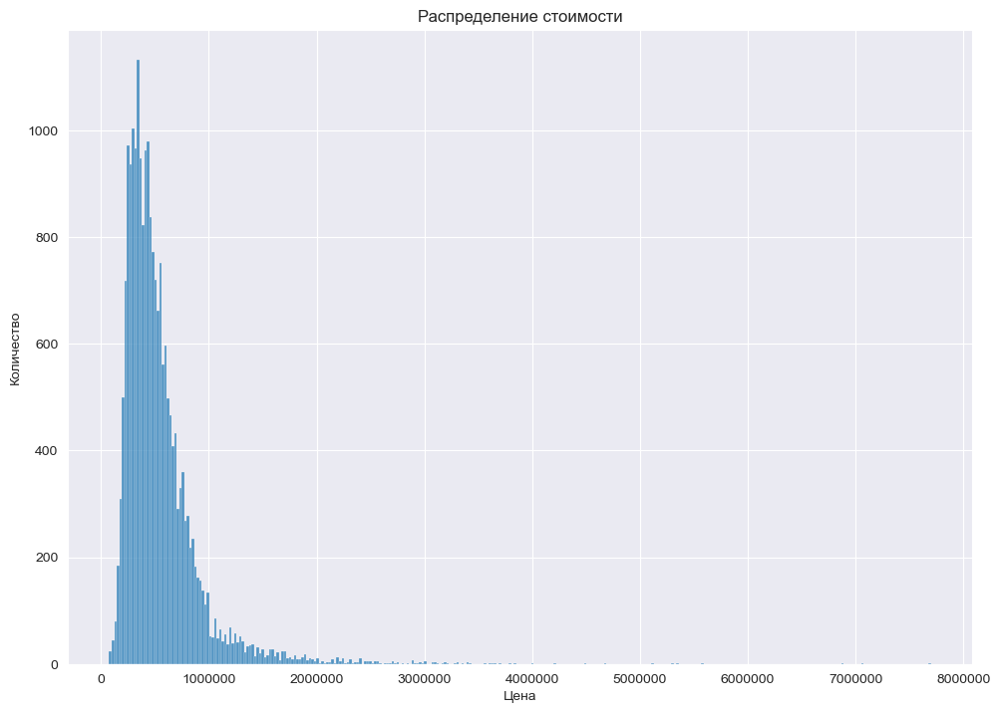

In [3]:
plt.figure(figsize = (11.7, 8.27))
sns.set_style("darkgrid")
sns.histplot(df['price'])
plt.title('Распределение стоимости')
plt.ticklabel_format(style='plain', axis='x')
plt.xlabel('Цена')
plt.ylabel('Количество');

### 1.3 Изучите распределение квадратуры жилой площади

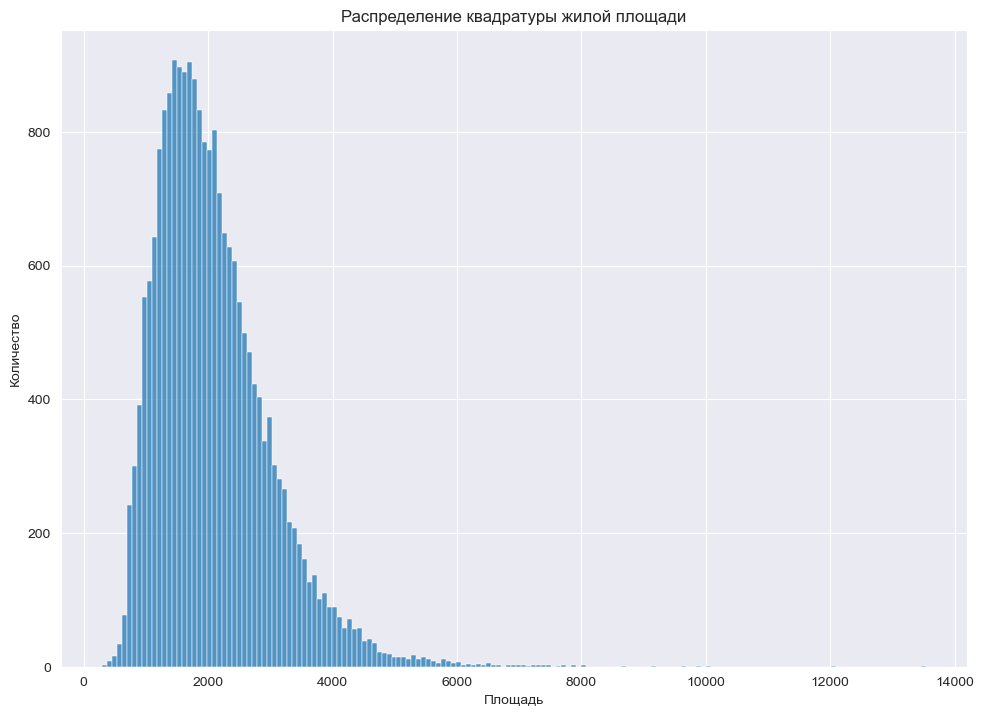

In [4]:
plt.figure(figsize = (11.7, 8.27))
sns.set_style("darkgrid")
sns.histplot(df['sqft_living'])
plt.title('Распределение квадратуры жилой площади')
plt.xlabel('Площадь')
plt.ylabel('Количество');

### 1.4 Изучите распределение года постройки

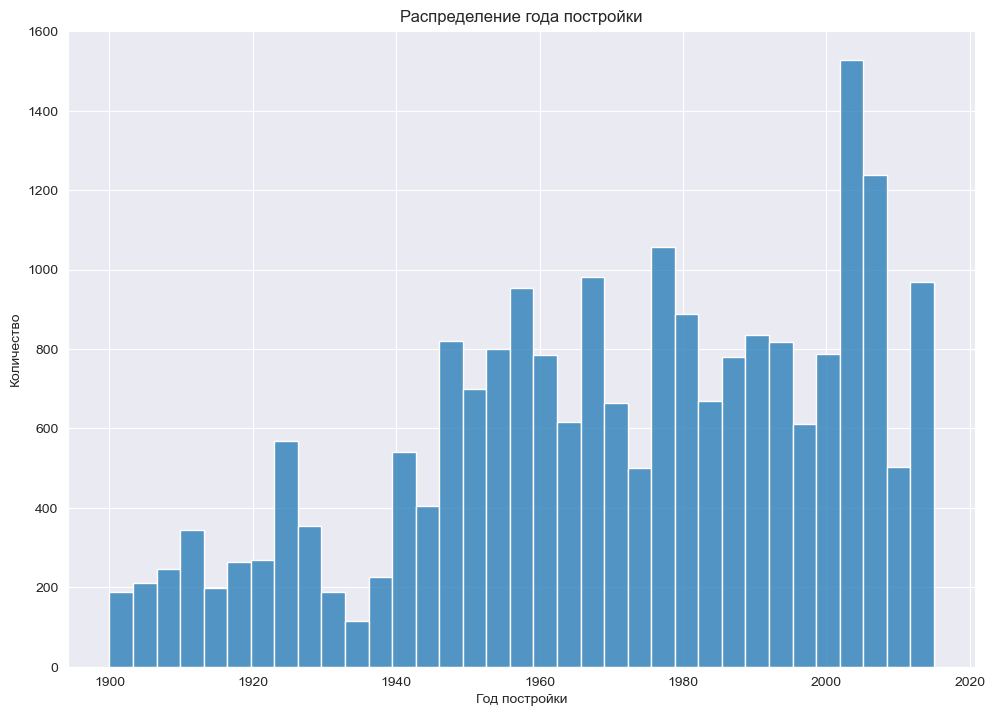

In [5]:
plt.figure(figsize = (11.7, 8.27))
sns.set_style("darkgrid")
sns.histplot(df['yr_built'])
plt.title('Распределение года постройки')
plt.xlabel('Год постройки')
plt.ylabel('Количество');

## Задача 2


### 2.1 Изучите распределение домов от наличия вида на набережную. Постройте график. Сделайте выводы

In [6]:
data21 = df['waterfront'].value_counts()
data21.rename({0: 'Without waterfront', 1: 'With waterfront'},inplace=True) 


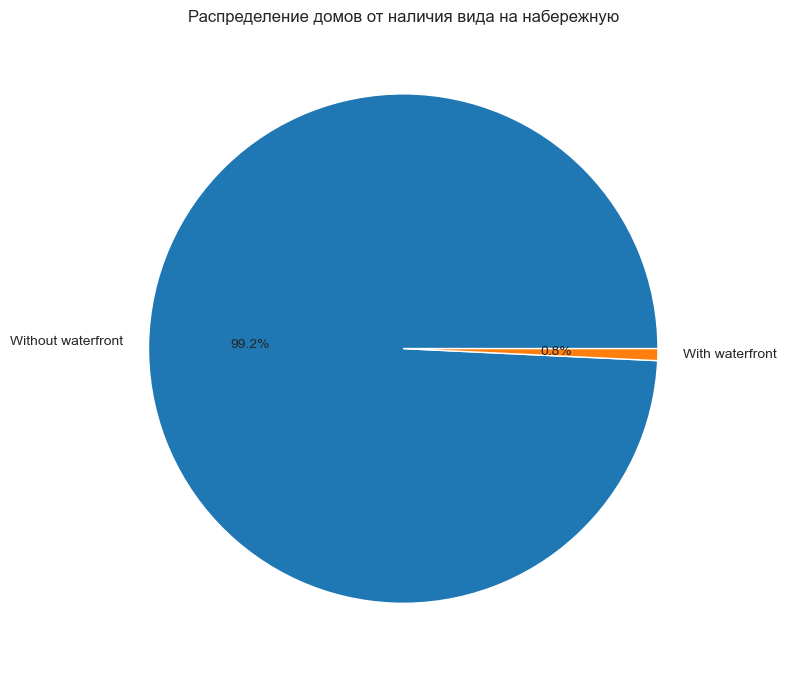

In [7]:
plt.figure(figsize = (11.7, 8.27))
plt.pie(data21 , autopct = '%1.1f%%',labels = data21.index);
plt.title('Распределение домов от наличия вида на набережную');

### 2.2 Изучите распределение этажей домов 

In [8]:
data22 = df['floors'].value_counts().reset_index()
data22

,index,floors
0,1.0,10680
1,2.0,8241
2,1.5,1910
3,3.0,613
4,2.5,161
5,3.5,8


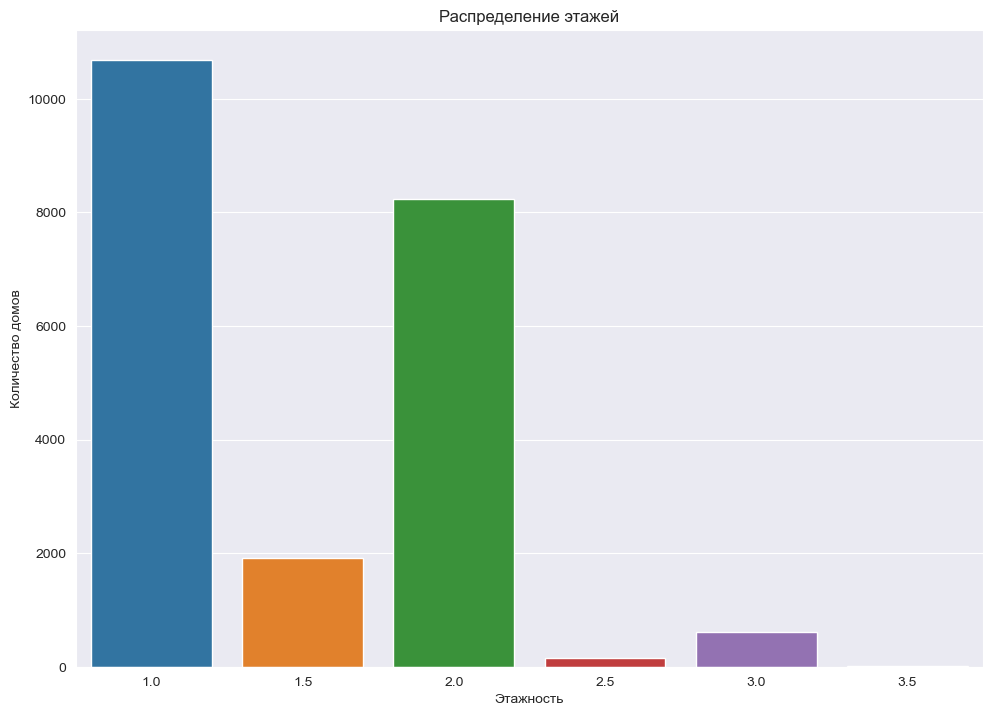

In [9]:
plt.figure(figsize = (11.7, 8.27))
sns.barplot(x = data22['index'], y = data22['floors'])
plt.title('Распределение этажей')
plt.xlabel('Этажность')
plt.ylabel('Количество домов');

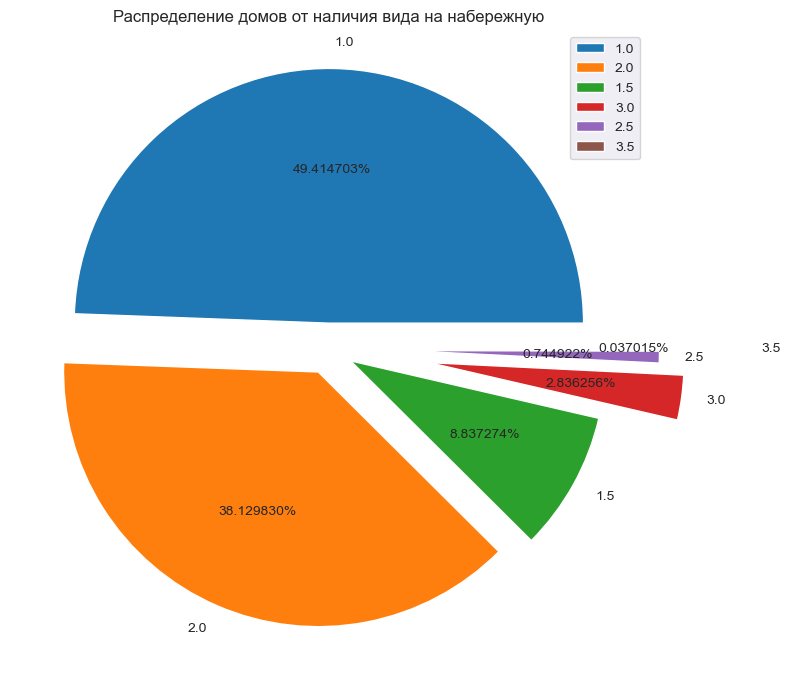

In [10]:
plt.figure(figsize = (11.7, 8.27))
explode_pie = [0.1,0.1,0.1,0.4,0.3,0.6]
plt.pie(data22['floors'] , autopct = '%1f%%',labels = data22['index'],explode = explode_pie,radius=1);
plt.legend(data22['index'], loc = 'best')
plt.title('Распределение домов от наличия вида на набережную');

### 2.3  Изучите распределение состояния домов

In [11]:
data23 = df['condition'].value_counts().reset_index()
data23

,index,condition
0,3,14031
1,4,5679
2,5,1701
3,2,172
4,1,30


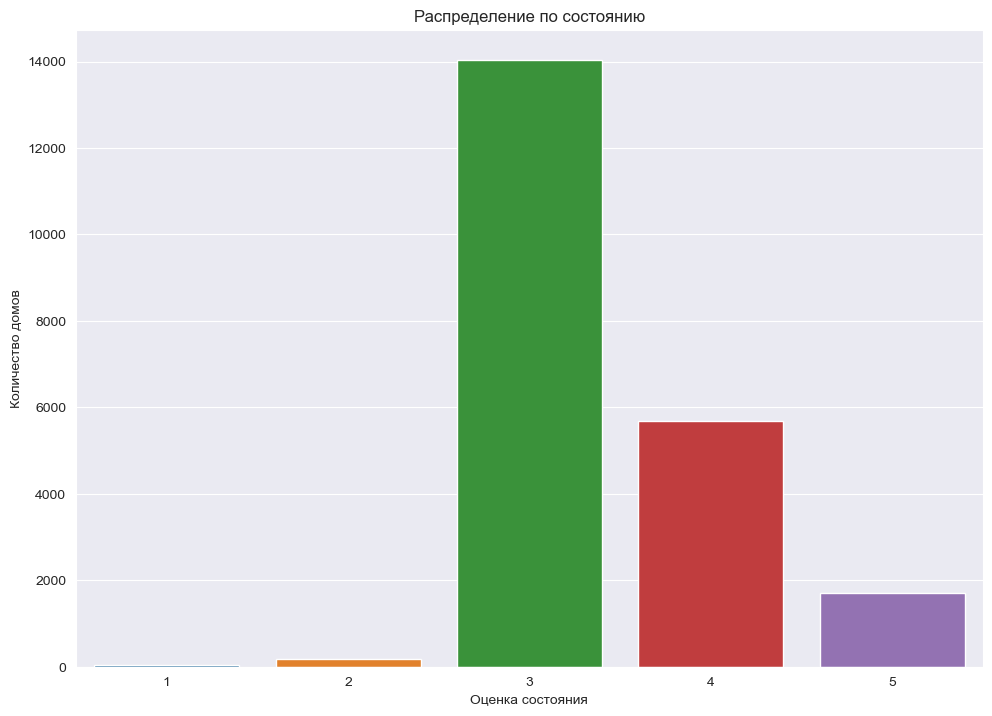

In [12]:
plt.figure(figsize = (11.7, 8.27))
sns.barplot(x = data23['index'], y = data23['condition'])
plt.title('Распределение по состоянию')
plt.xlabel('Оценка состояния')
plt.ylabel('Количество домов');

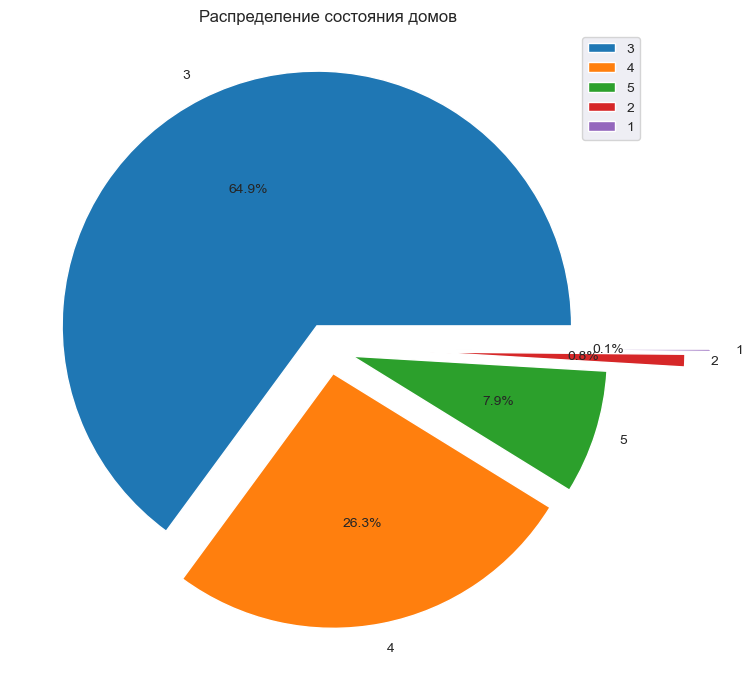

In [13]:
plt.figure(figsize = (11.7, 8.27))
explode_pie23 = [0.1,0.1,0.1,0.4,0.5]
plt.pie(data23['condition'] , autopct = '%1.1f%%',labels = data23['index'],explode = explode_pie23);
plt.legend(data23['index'], loc = 'best')
plt.title('Распределение состояния домов');

## Задача 3

#### Исследуйте, какие характеристики недвижимости влияют на стоимость недвижимости, с применением не менее 5 диаграмм из урока. Анализ сделайте в формате storytelling: дополнить каждый график письменными выводами и наблюдениями.

### 3.1 Построим корреляционную матрицу и тепловую карту

In [14]:
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix,1)
corr_matrix[np.abs(corr_matrix)<0.3] =0 
corr_matrix

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
id,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
price,0.0,1.0,0.3,0.5,0.7,0.0,0.3,0.3,0.4,0.0,0.7,0.6,0.3,0.0,0.0,0.0,0.3,0.0,0.6,0.0
bedrooms,0.0,0.3,1.0,0.5,0.6,0.0,0.0,0.0,0.0,0.0,0.4,0.5,0.3,0.0,0.0,0.0,0.0,0.0,0.4,0.0
bathrooms,0.0,0.5,0.5,1.0,0.8,0.0,0.5,0.0,0.0,0.0,0.7,0.7,0.3,0.5,0.0,0.0,0.0,0.0,0.6,0.0
sqft_living,0.0,0.7,0.6,0.8,1.0,0.0,0.4,0.0,0.3,0.0,0.8,0.9,0.4,0.3,0.0,0.0,0.0,0.0,0.8,0.0
sqft_lot,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7
floors,0.0,0.3,0.0,0.5,0.4,0.0,1.0,0.0,0.0,-0.3,0.5,0.5,0.0,0.5,0.0,0.0,0.0,0.0,0.3,0.0
waterfront,0.0,0.3,0.0,0.0,0.0,0.0,0.0,1.0,0.4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
view,0.0,0.4,0.0,0.0,0.3,0.0,0.0,0.4,1.0,0.0,0.3,0.0,0.3,0.0,0.0,0.0,0.0,0.0,0.3,0.0
condition,0.0,0.0,0.0,0.0,0.0,0.0,-0.3,0.0,0.0,1.0,0.0,0.0,0.0,-0.4,0.0,0.0,0.0,0.0,0.0,0.0


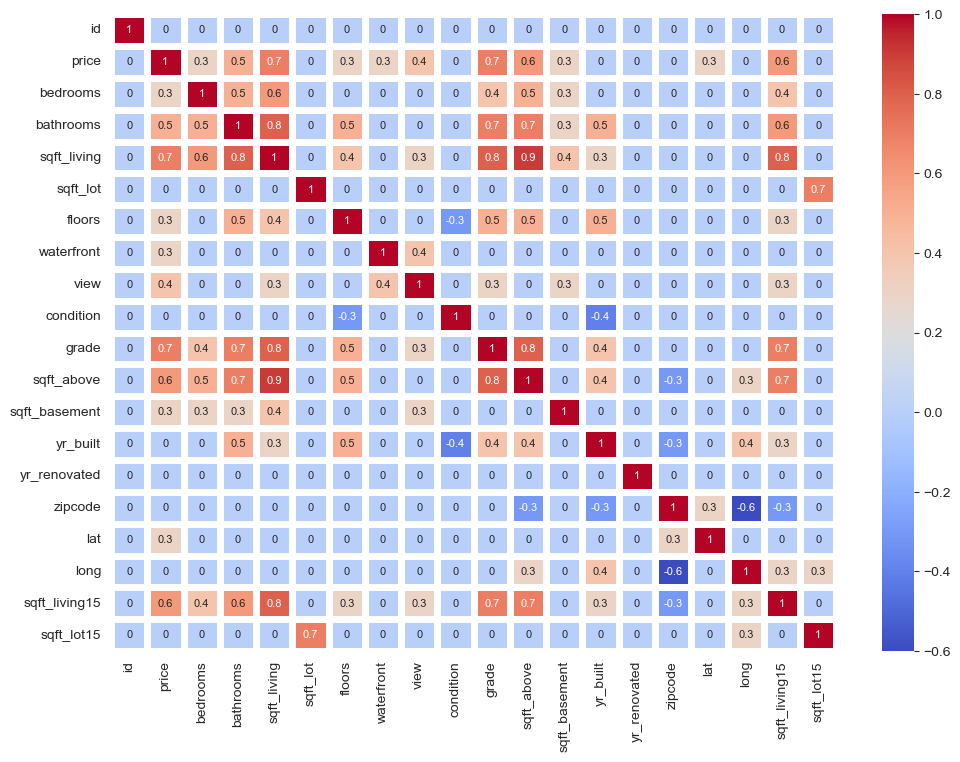

In [15]:
plt.figure(figsize = (11.7, 8.27))
sns.heatmap(corr_matrix, annot = True, linewidths = 5,  annot_kws={"fontsize":8},cmap = 'coolwarm');

Наблюдается  прямая корреляция (k = 0.7):
1. между ценой и площадью (k= 0.7) 
2. между ценой и конструкцией здания и дизайном (k= 0.7)


### 3.1 Рассмотрим зависимость между ценой и площадью

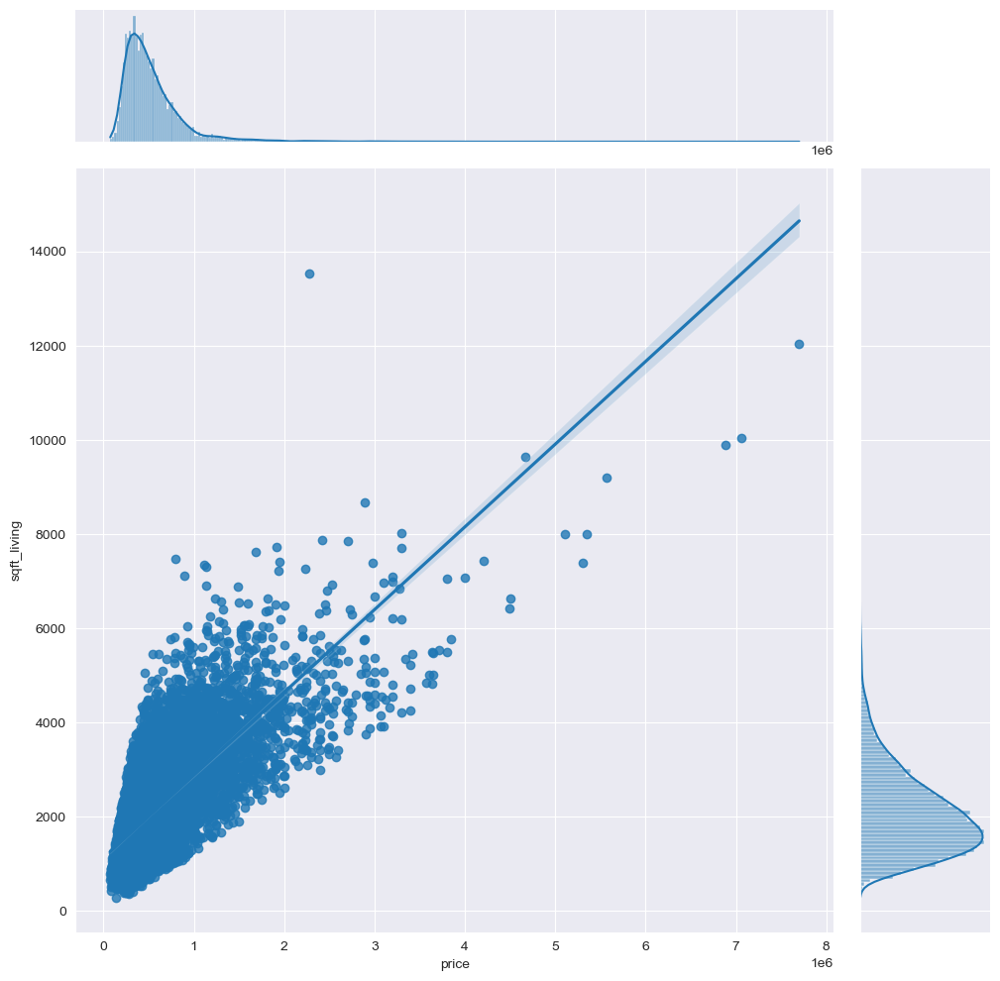

In [16]:
sns.jointplot(x = df['price'], y = df['sqft_living'],kind="reg",height = 10);


На графике видим рост цены вместе с ростом жилой площади

### 3.2 Рассмотрим зависимость между ценой и конструкцией здания и дизайном

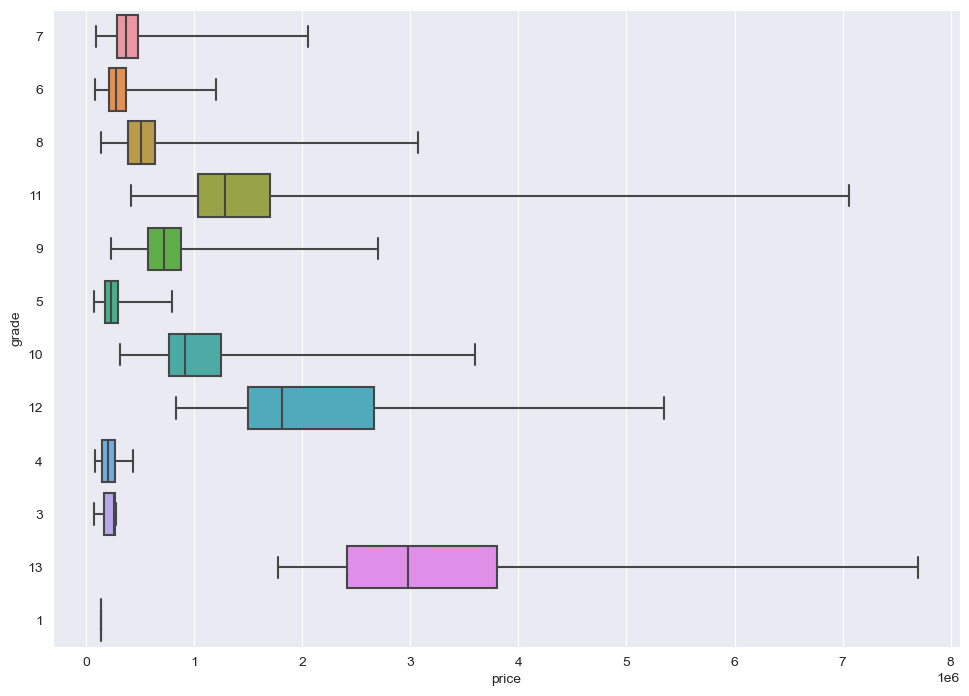

In [17]:
plt.figure(figsize = (11.7, 8.27))
sns.boxplot(x = df['price'], y = df['grade'].astype('str'),whis = 15);

 Исходя из условия, что значение ['grade'] от 1 до 13, где 1-3 плохая конструкция здания и дизайн, 7 - средний уровень конструкции и дизайна, 11-13 - высокое качество конструкции и дизайна, видим, что средняя цена зданиий с оценкой от 11 до 13 выше чем у всех остальных категорий. Графики категорий 11-13 лежат правее остальных и это указывает на то, что чем лучше конструкция и дизайн дома, тем выше его стоимость.

### 3.3 Рассмотрим зависимость между ценой и кв. метрами жилой площади у 15 соседей (k= 0.6)

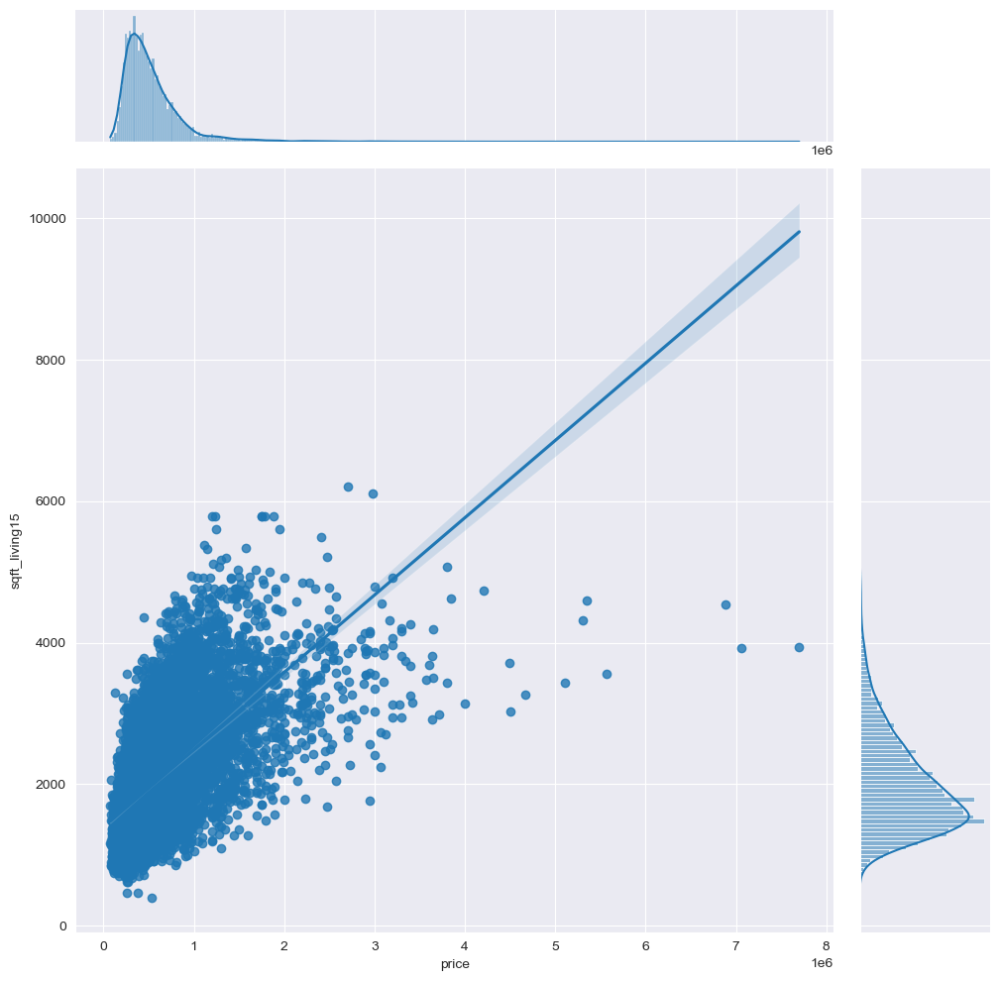

In [18]:
sns.jointplot(x = df['price'], y = df['sqft_living15'],kind="reg",height=10)
plt.xlabel('Стоимость')
plt.ylabel('Кв.метры соседей');


Видим прямую зависимость между стоимостью дома и кв. метрами жилой площади у 15 соседей. Вероятнее всего - большой размер соседской жилой площади указывает на кварталы, где население обладает большим финансовым уровнем - и как следствие стоимость жилья там выше.

### 3.4 Анализ геоданных

Рассмотрим зависимость признака долготы и широты

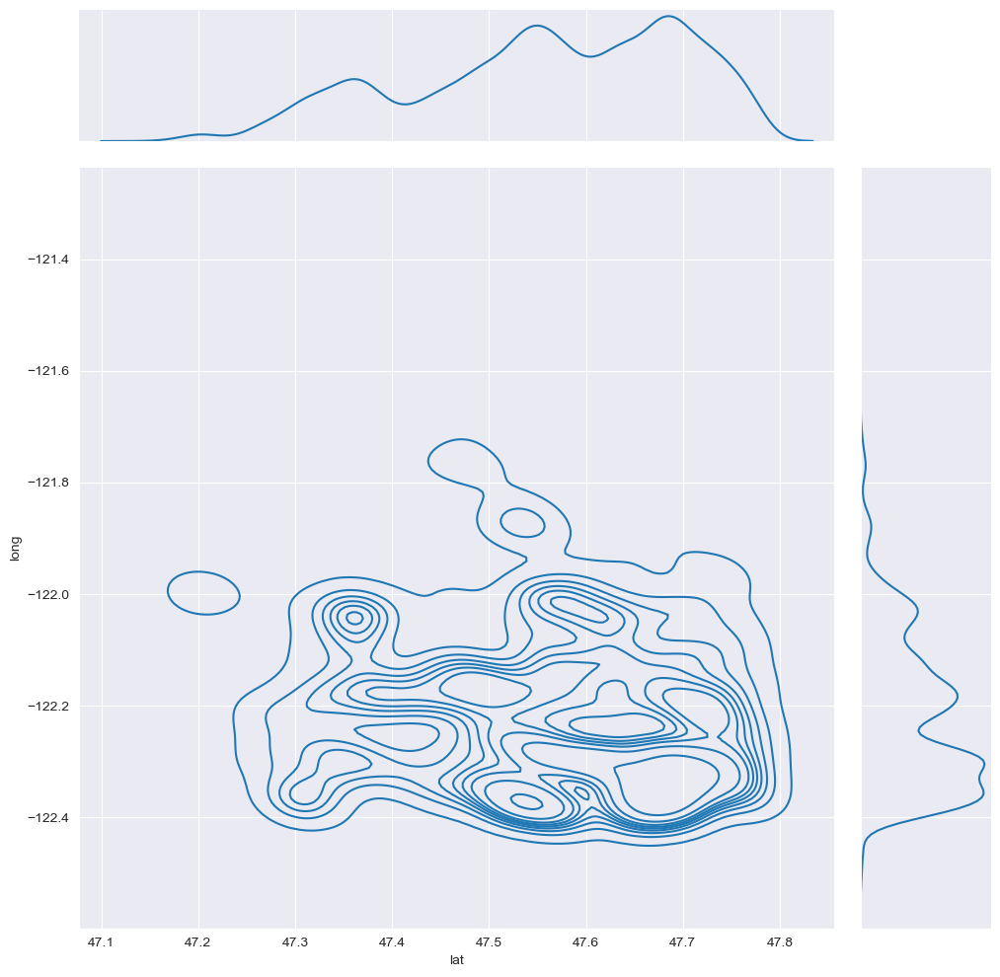

In [19]:
sns.jointplot(x=df['lat'], y=df['long'], height = 10,kind='kde');

In [20]:
import folium

In [21]:
realty_map = folium.Map(prefer_canvas=True)

def plotDot(point):
    folium.CircleMarker(
        location=[point.lat, point.long],
        radius=2,
        popup=point.price
    ).add_to(realty_map)


df.apply(plotDot, axis=1)

realty_map.fit_bounds(realty_map.get_bounds())
realty_map